<center><br> <center><strong style="font-size: 30px;"> ML1: CUSTOMER CLASSIFICATION </strong></center>
</center> <br> <center><b style="font-size: 20px;">Prepared By - Subhasish Sinha</b></center>

---
# **Table of Contents**
---

**1.** [**Introduction**](#Section1)<br>
**2.** [**Problem Statement**](#Section2)<br>
**3.** [**Instaling & Importing Libraries**](#Section3)<br>
**4.** [**Data Acquisition & Description**](#Section4)<br>
  - **4.1** [**Data Description**](#Section41)
  - **4.2** [**Data Information**](#Section42)

**5.** [**Data Pre-Processing**](#Section6)<br>
  - **5.1** [**Data Pre-Profiling**](#Section51)<br>
  - **5.2** [**Data Cleaning**](#Section52)<br>
  - **5.3** [**Data Post-Profiling**](#Section53)<br>

**6.** [**Exploratory Data Analysis**](#Section6)<br>
**7.** [**Data Post-Processing**](#Section7)<br>
**8.** [**Modelling Development & Evaluation**](#Section8)<br>

**9.** [**Conclusion**](#section9)

---
<a name = Section1></a>
# **1. Introduction**
---

In the dynamic world of retail banking, the introduction of value-added services is crucial for maintaining competitive advantage and customer satisfaction. One such service that has gained prominence is stock trading facilities, offering customers an avenue to invest and grow their wealth directly through their trusted banking partner.

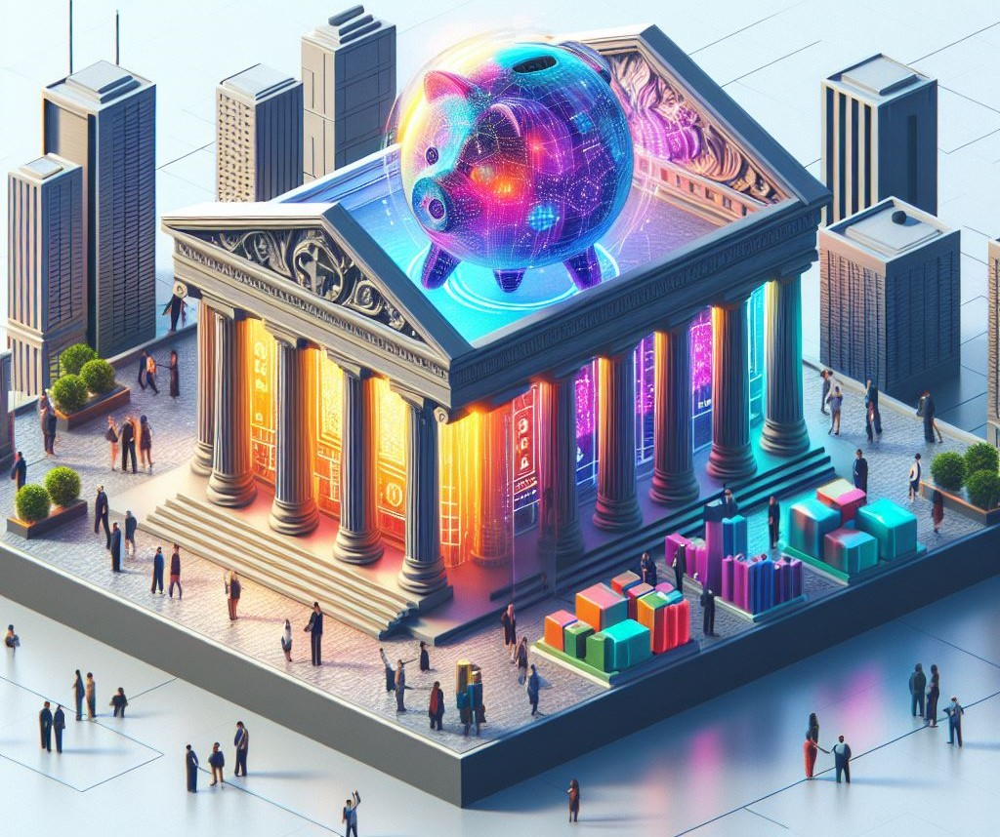

Our client, a well-established retail banking institution, has recognized this opportunity and launched a stock trading facility for their existing customers. This strategic move is not only an expansion of their service portfolio but also a step towards deepening customer relationships and enhancing revenue streams. The banking sector's inherent trust and substantial customer base provide a fertile ground for such cross-selling initiatives.

However, with every new venture comes its unique challenges and the need for strategic customer segmentation to maximize return on investment. The client's initiative now is to refine their approach by understanding and categorizing their customer base more effectively.

---
<a name = Section2></a>
# **2. Problem Statement**
---
The core challenge lies in accurately identifying and classifying customers into two distinct groups: high net worth and low net worth individuals. This classification is crucial as it directly impacts the bank's strategy in incentivizing customer participation in the stock trading facility.

Currently, the bank faces a specific issue: only about 10% of their customers engage in trading activities sufficiently enough to make the earnings, after factoring in discounts, profitable for the bank. The goal is to pinpoint these high-engagement customers to tailor the bank's marketing and incentive strategies more effectively.

The task at hand is to develop a robust classification model using historical customer data. This model aims to predict whether a future customer belongs to a high net worth or low net worth group based on various attributes like occupation, income, investment behavior, and more. The bank intends to use these insights to craft targeted strategies that will encourage trading activity among the most promising customer segments, thus optimizing resource allocation and maximizing the profitability of this new service offering.

---
<a name = Section3></a>
# **3. Installing & Importing Libraries**
---


In [36]:
import numpy as np
import pandas as pd    
import matplotlib.pyplot as plt
import seaborn as sns
from ydata_profiling import ProfileReport
from sklearn.preprocessing import LabelEncoder, StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import Pipeline

import warnings                                                     # Importing warning to disable runtime warnings
warnings.filterwarnings("ignore")                                   # Warnings will appear only once

---
<a name = Section4></a>
# **4. Data Acquisition & Description**
---
|Feature|Description|
|:--|:--|
Column Name|	Description
REF_NO|	Reference Number of the customer.
children|	Number of children each customer has.
Age_band|	Age Group to which the customer belongs.
status|	Marital Status of the customer.
occupation|	Job or profession of the customer.
occupation_partner|	Job or profession of the customer's partner.
home_status|	Home Status of the customers.
family_income|	Income Range of the customer's family.
self_employed|	Whether self-employed or not.
self_employed_partner|	Whether the partner self-employed or not.
year_last_moved|	Moving Year from the last location of the customer.
TVarea|	Television Region of the customer.
post_code|	Postal Code of the customer.
post_area|	Postal Area of the customer.
Average_Credit_Card_Transaction|	Average Credit Card Transaction per year by the customer.
Balance_Transfer|	Transfer of the Balance in an account to another account by the customer.
Term_Deposit|	Cash Investment Help at Financial Institute provided to the customer.
Life_Insurance|	Basic Life Insurance Coverage of the customer.
Medical_Insurance|	Medical Insurance Coverage of the customer.
Average_A/C_Balance|	Average Balance in the account of the customer.
Personal_Loan|	Amount of Personal Loan taken by the customer..
Investment_in_Mutual_Fund|	Amount Invested in Mutual Funds by the customer.
Investment_Tax_Saving_Bond|	Amount Invested in Tax Saving Bond by the customer.
Home_Loan|	Amount of Home Loan taken by the customer.
Online_Purchase_Amount|	Amount spent by the customer on online purchases.
gender|	Gender of the customer.
region|	Region of the customer.
Investment_in_Commudity|	Amount Invested in Commodity by the customer.
Investment_in_Equity|	Amount Invested in Equity by the customer.
Investment_in_Derivative|	Amount Invested in Derivatives by the customer.
Portfolio_Balance|	Balanced Investment Strategy of the customer.
Revenue_Grid|	Grid report of the customers.

In [2]:
# Load the training dataset
train_data_path = 'E:\DATA SCIENCE\MLProjects\Customer-classification\existing_base_train.csv'
train_data = pd.read_csv(train_data_path)

# Display basic information and the first few rows of the dataset
print('Shape of the dataset:', train_data.shape)

train_data.head(10)

Shape of the dataset: (8124, 32)


,REF_NO,children,age_band,status,occupation,occupation_partner,home_status,family_income,self_employed,self_employed_partner,...,Investment_Tax_Saving_Bond,Home_Loan,Online_Purchase_Amount,gender,region,Investment_in_Commudity,Investment_in_Equity,Investment_in_Derivative,Portfolio_Balance,Revenue_Grid
0,5466,2,31-35,Partner,Professional,Professional,Own Home,">=35,000",No,No,...,8.98,55.44,7.68,Female,North West,151.55,81.79,136.02,360.37,2
1,9091,Zero,45-50,Partner,Secretarial/Admin,Professional,Own Home,">=35,000",No,No,...,0.00,0.00,18.99,Female,North West,44.28,13.91,29.23,89.22,2
2,9744,1,36-40,Partner,Manual Worker,Manual Worker,Rent Privately,"<22,500, >=20,000",Yes,Yes,...,0.00,0.00,0.00,Female,South West,8.58,1.75,4.82,14.50,2
3,10700,2,31-35,Partner,Manual Worker,Manual Worker,Own Home,"<25,000, >=22,500",No,No,...,0.00,0.00,0.00,Female,Scotland,15.00,0.00,5.00,68.98,2
4,1987,Zero,55-60,Partner,Housewife,Professional,Own Home,">=35,000",No,No,...,0.00,0.00,0.00,Female,Unknown,0.00,1.66,1.66,1.88,2
5,3309,Zero,45-50,Partner,Secretarial/Admin,Business Manager,Own Home,">=35,000",No,No,...,0.00,0.00,0.00,Female,Northern Ireland,13.18,4.83,14.23,33.62,2
6,6610,Zero,36-40,Partner,Secretarial/Admin,Secretarial/Admin,Own Home,"<30,000, >=27,500",Yes,No,...,1.00,3.99,5.49,Female,West Midlands,2.00,23.48,21.90,13.12,2
7,10621,Zero,61-65,Partner,Retired,Retired,Own Home,"<20,000, >=17,500",No,No,...,0.00,0.00,0.00,Male,North West,0.00,4.99,4.99,15.74,2
8,2630,1,45-50,Partner,Professional,Professional,Own Home,">=35,000",No,No,...,0.00,0.00,0.00,Female,Unknown,27.18,4.83,13.66,36.05,2
9,9356,3,36-40,Partner,Professional,Housewife,Own Home,"<27,500, >=25,000",Yes,No,...,24.47,0.00,0.00,Male,North West,0.00,6.74,6.74,8.60,2


In [3]:
# Load the test dataset
test_data_path = 'E:\DATA SCIENCE\MLProjects\Customer-classification\existing_base_test.csv'
test_data = pd.read_csv(test_data_path)

# Display basic information and the first few rows of the dataset
print('Shape of the dataset:', test_data.shape)

test_data.head(10)

Shape of the dataset: (2031, 31)


,REF_NO,children,age_band,status,occupation,occupation_partner,home_status,family_income,self_employed,self_employed_partner,...,Investment_in_Mutual_Fund,Investment_Tax_Saving_Bond,Home_Loan,Online_Purchase_Amount,gender,region,Investment_in_Commudity,Investment_in_Equity,Investment_in_Derivative,Portfolio_Balance
0,697,Zero,71+,Partner,Retired,Housewife,Own Home,"<12,500, >=10,000",No,No,...,45.97,0.00,0.00,0.00,Male,South West,40.48,15.07,28.40,83.05
1,7897,Zero,31-35,Partner,Unknown,Business Manager,Own Home,">=35,000",No,No,...,133.88,27.45,13.47,57.46,Male,South East,27.07,72.01,82.74,235.29
2,4729,Zero,71+,Partner,Housewife,Retired,Own Home,"<15,000, >=12,500",No,No,...,107.88,0.00,0.00,0.00,Female,South West,44.39,32.62,43.86,98.38
3,6914,1,22-25,Partner,Other,Other,Own Home,"<17,500, >=15,000",No,No,...,44.96,0.00,0.00,0.00,Female,Scotland,21.59,24.57,29.23,86.32
4,2795,Zero,65-70,Widowed,Retired,Unknown,Own Home,"< 4,000",No,No,...,33.96,6.99,17.93,5.45,Female,South East,53.66,16.22,32.89,102.99
5,7367,1,36-40,Partner,Secretarial/Admin,Professional,Own Home,"<22,500, >=20,000",No,No,...,67.43,0.00,5.47,0.00,Female,North,30.78,64.10,79.76,132.74
6,9598,Zero,51-55,Widowed,Secretarial/Admin,Unknown,Own Home,"<20,000, >=17,500",No,No,...,0.00,5.98,0.00,0.00,Female,Unknown,5.00,1.00,1.00,6.55
7,6704,2,36-40,Partner,Secretarial/Admin,Professional,Own Home,">=35,000",No,No,...,43.98,3.00,0.00,0.00,Female,Unknown,68.98,17.24,42.97,154.46
8,4933,3,31-35,Partner,Secretarial/Admin,Professional,Own Home,">=35,000",No,No,...,0.00,0.00,0.00,0.00,Female,North West,0.10,0.00,0.00,22.35
9,9880,2,45-50,Partner,Secretarial/Admin,Manual Worker,Own Home,"<17,500, >=15,000",No,No,...,127.36,0.00,0.00,0.00,Female,North West,86.35,35.31,97.68,200.36


<a name = Section41></a>
### **4.1 Data Description**
- In this section we will get **information about the data** and see some observations.

In [4]:
train_data.describe()

,REF_NO,year_last_moved,Average_Credit_Card_Transaction,Balance_Transfer,Term_Deposit,Life_Insurance,Medical_Insurance,Average_A/C_Balance,Personal_Loan,Investment_in_Mutual_Fund,Investment_Tax_Saving_Bond,Home_Loan,Online_Purchase_Amount,Investment_in_Commudity,Investment_in_Equity,Investment_in_Derivative,Portfolio_Balance,Revenue_Grid
count,8124.000000,8124.000000,8124.000000,8124.000000,8124.000000,8124.000000,8124.000000,8124.000000,8124.00000,8124.000000,8124.000000,8124.000000,8124.000000,8124.000000,8124.000000,8124.000000,8124.000000,8124.000000
mean,5797.343304,1967.876908,23.251094,46.082922,27.284649,65.317939,18.826195,31.838023,25.41583,41.723628,6.057246,4.416914,19.198658,36.152749,21.442475,31.530652,89.353368,1.894141
std,3322.497568,182.563785,51.147496,79.084692,54.133537,95.762451,32.022332,45.249440,85.13015,64.416023,12.673374,9.945747,92.343126,42.474953,32.261660,39.480660,108.303538,0.307676
min,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-78.430000,1.000000
25%,2924.750000,1978.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,8.282500,4.660000,8.740000,26.277500,2.000000
50%,5811.500000,1988.000000,0.000000,17.485000,0.000000,31.475000,0.010000,14.980000,0.00000,23.480000,0.000000,0.000000,0.000000,23.590000,12.820000,21.140000,65.560000,2.000000
75%,8681.500000,1994.000000,23.480000,64.990000,34.490000,92.887500,26.970000,45.922500,20.82750,59.440000,5.490000,4.490000,7.480000,49.795000,27.972500,42.392500,123.970000,2.000000
max,11518.000000,1999.000000,662.260000,2951.760000,784.820000,2930.410000,591.040000,626.240000,4905.93000,2561.270000,156.870000,162.350000,4306.420000,1231.090000,1279.100000,1771.160000,4283.560000,2.000000


**Observations**:

1. The dataset contains 8124 records.
2. The year_last_moved feature indicates that the customers have been with the bank for a considerable amount of time, as the mean year of last move is around 1967.
3. The Average_Credit_Card_Transaction feature has a mean of approximately 23.25, but with a high standard deviation of 51.15, indicating a wide spread in the credit card transaction amounts.
4. The Balance_Transfer feature has a mean of approximately 46.08, suggesting that on average, customers have transferred this amount of balance.
5. The Life_Insurance feature has a mean of approximately 65.32, indicating that on average, customers have this amount in life insurance.
6. The Average_A/C_Balance feature has a mean of approximately 31.84, suggesting that on average, customers have this balance in their accounts.
7. The Investment_in_Mutual_Fund feature has a mean of approximately 41.72, indicating that on average, customers have invested this amount in mutual funds.
8. The Online_Purchase_Amount feature has a mean of approximately 19.20, suggesting that on average, customers have spent this amount on online purchases.
9. The Portfolio_Balance feature has a mean of approximately 89.35, indicating the average balance of customers’ portfolios.
10. The Revenue_Grid feature, which could be the target variable for classification, has a mean of approximately 1.89, suggesting that the classes are somewhat imbalanced.

<a name = Section42></a>
### **4.2 Data Information**

- In this section we will see the **information about the types of features**.

In [5]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8124 entries, 0 to 8123
Data columns (total 32 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   REF_NO                           8124 non-null   int64  
 1   children                         8124 non-null   object 
 2   age_band                         8124 non-null   object 
 3   status                           8124 non-null   object 
 4   occupation                       8124 non-null   object 
 5   occupation_partner               8124 non-null   object 
 6   home_status                      8124 non-null   object 
 7   family_income                    8124 non-null   object 
 8   self_employed                    8124 non-null   object 
 9   self_employed_partner            8124 non-null   object 
 10  year_last_moved                  8124 non-null   int64  
 11  TVarea                           8124 non-null   object 
 12  post_code           

**Observations**:

- The dataset has **8124** rows, and **32** features.

- We can see that **majority** of columns are of **float64** and **Object** datatype.


In [6]:
test_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2031 entries, 0 to 2030
Data columns (total 31 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   REF_NO                           2031 non-null   int64  
 1   children                         2031 non-null   object 
 2   age_band                         2031 non-null   object 
 3   status                           2031 non-null   object 
 4   occupation                       2031 non-null   object 
 5   occupation_partner               2031 non-null   object 
 6   home_status                      2031 non-null   object 
 7   family_income                    2031 non-null   object 
 8   self_employed                    2031 non-null   object 
 9   self_employed_partner            2031 non-null   object 
 10  year_last_moved                  2031 non-null   int64  
 11  TVarea                           2031 non-null   object 
 12  post_code           

<a name = Section51></a>

---
# **5. Data Pre-Processing**
---

<a name = Section51></a>

### **5.1 Data Pre-Profiling**

- For **quick analysis** pandas profiling is very handy.

- Generates profile reports from a pandas DataFrame.

- For each column **statistics** are presented in an interactive HTML report.

In [10]:
# Profile Report
profile = ProfileReport(df=train_data)
print('Accomplished!')

profile.to_notebook_iframe()

Accomplished!


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

**Observations**:
1. High Correlation Issues:

>Several features show high correlation with each other. High correlation between variables can lead to multicollinearity, which can adversely affect some models, particularly linear models.
Action: Consider removing or combining highly correlated features. For instance, if two features are highly correlated, you might choose to keep only one of them or create a new feature that captures their combined effect.

2. Imbalanced Features:

>'home_status', 'self_employed', and 'Revenue_Grid' are imbalanced. Imbalance in the target variable ('Revenue_Grid') is particularly concerning as it can lead to a model biased towards the majority class.
 Action: For imbalanced features, consider techniques like oversampling the minority class, undersampling the majority class, or using advanced methods like SMOTE. For the imbalanced target variable, ensure to use evaluation metrics that handle imbalance well, like the F1 Score.

3. Skewed Features:

> 'Personal_Loan' and 'Online_Purchase_Amount' are highly skewed.
Action: Apply transformations like log, square root, or Box-Cox to reduce skewness and normalize these distributions.

4. Unique and Uniformly Distributed Features:

>'REF_NO' is uniformly distributed and has unique values, indicating it's likely an identifier.
Action: Remove 'REF_NO' from the feature set as it does not contribute to predictive power.

5. Features with High Proportion of Zeros:

>Several features have a high percentage of zero values. This might indicate sparse data or features that are not applicable to all customers.
Action: Depending on the nature of these features, you might consider treating zeros as a separate category, especially if the zero has a specific meaning (like no investment or no loan).

<a name = Section51></a>

### **5.2 Data Pre-Cleaning**

In [7]:
# Check for missing values in the dataset
missing_values = train_data.isnull().sum()
missing_values[missing_values > 0] # Display columns with missing values, if any

Series([], dtype: int64)

In [8]:
# Check for missing values in the dataset
missing_values_test = test_data.isnull().sum()
missing_values_test[missing_values_test > 0] # Display columns with missing values, if any

Series([], dtype: int64)

In [9]:
train_data.drop(['REF_NO', 'post_code','post_area','region'], axis=1, inplace=True)
test_data.drop(['REF_NO', 'post_code','post_area','region'], axis=1, inplace=True)

In [10]:
# Identifying categorical and numerical columns in the training data
categorical_cols_train = train_data.select_dtypes(include=['object']).columns.tolist()
numerical_cols_train = train_data.select_dtypes(include=['float64', 'int64']).columns.tolist()
numerical_cols_train.remove('Revenue_Grid')  # Removing the target variable

In [11]:
# Checking the number of unique values in each categorical column of train data
print("Number of unique values in each categorical column of Train data:")
for col in categorical_cols_train:
    print(f"{col}: {train_data[col].nunique()}")

Number of unique values in each categorical column of Train data:
children: 5
age_band: 13
status: 5
occupation: 9
occupation_partner: 9
home_status: 5
family_income: 13
self_employed: 2
self_employed_partner: 2
TVarea: 14
gender: 3


In [12]:
# Checking the number of unique values in each categorical column of test data
print("Number of unique values in each categorical column of Test data:")
for col in categorical_cols_train:
    print(f"{col}: {test_data[col].nunique()}")

Number of unique values in each categorical column of Test data:
children: 5
age_band: 13
status: 5
occupation: 9
occupation_partner: 9
home_status: 5
family_income: 13
self_employed: 2
self_employed_partner: 2
TVarea: 14
gender: 3


<a name = Section6></a>

---
# **6. Exploratory Data Analysis**
---

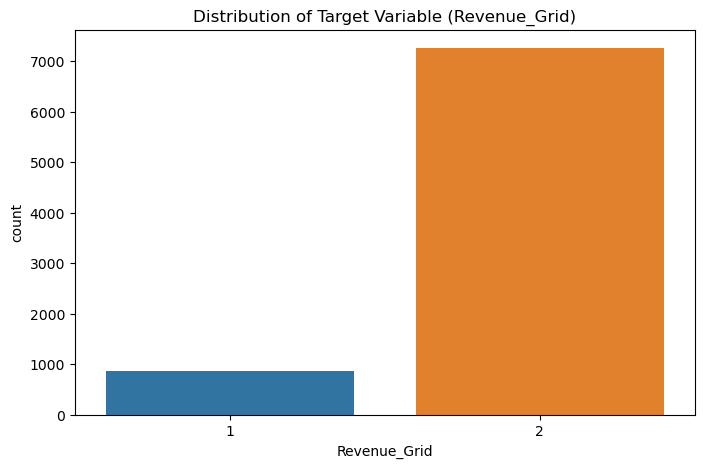

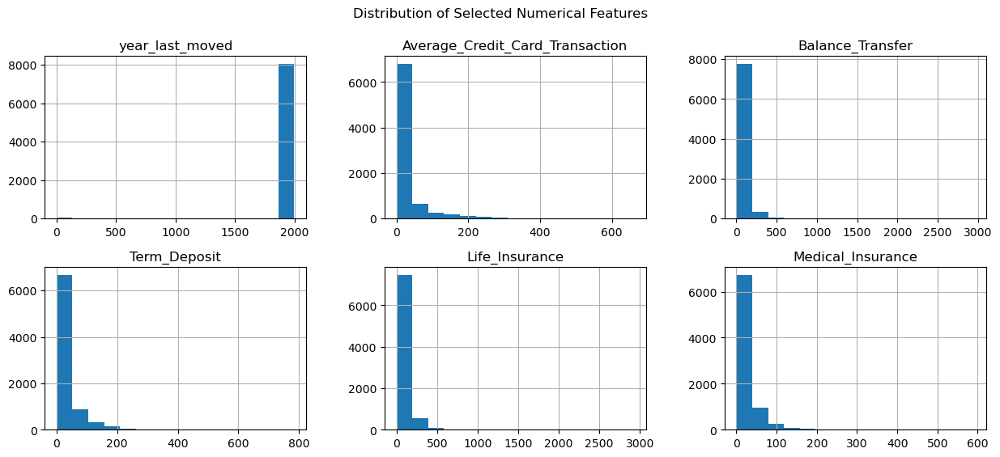

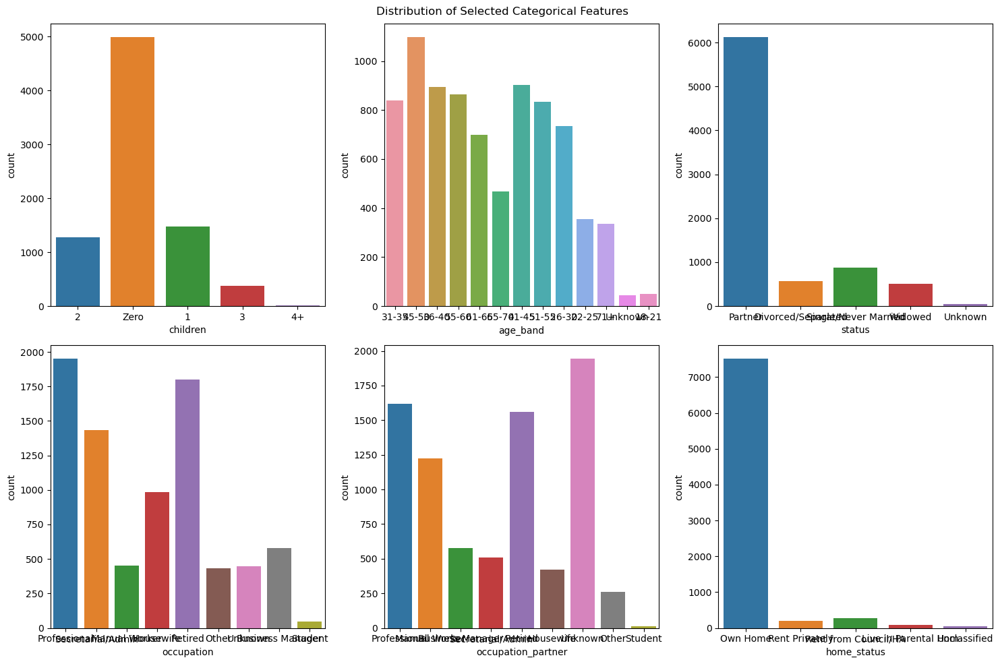

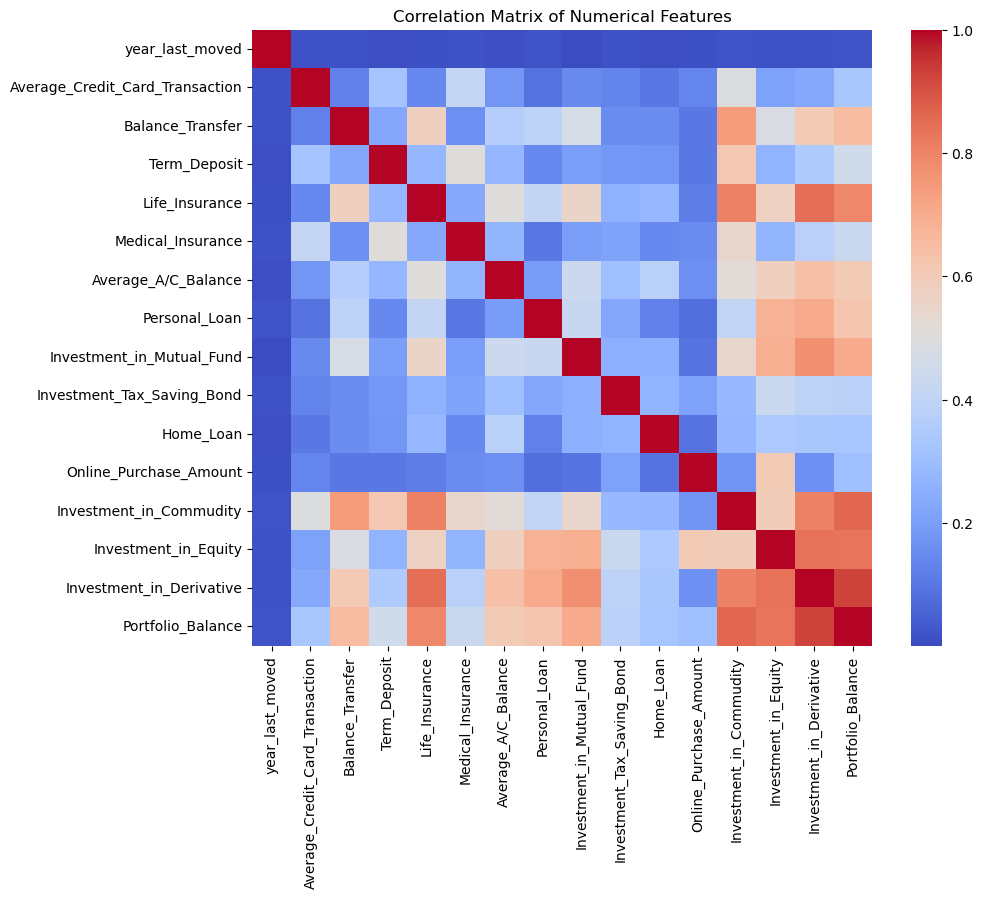

In [39]:
# 1. Target Variable Distribution
plt.figure(figsize=(8, 5))
sns.countplot(x='Revenue_Grid', data=train_data)
plt.title('Distribution of Target Variable (Revenue_Grid)')
plt.show()

# 2. Numerical Feature Distributions (selecting a few for visualization)
numerical_features_sample = numerical_cols_train[:6]  # Selecting first 6 numerical features for sample visualization
train_data[numerical_features_sample].hist(bins=15, figsize=(15, 6), layout=(2, 3))
plt.suptitle('Distribution of Selected Numerical Features')
plt.show()

# 3. Categorical Feature Distributions (selecting a few for visualization)
categorical_features_sample = categorical_cols_train[:6]  # Selecting first 6 categorical features for sample visualization
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(15, 10))
for i, col in enumerate(categorical_features_sample):
    sns.countplot(x=col, data=train_data, ax=axes[i//3, i%3])
plt.suptitle('Distribution of Selected Categorical Features')
plt.tight_layout()
plt.show()

# 4. Correlation Matrix (for numerical features)
plt.figure(figsize=(10, 8))
sns.heatmap(train_data[numerical_cols_train].corr(), annot=False, cmap='coolwarm')
plt.title('Correlation Matrix of Numerical Features')
plt.show()

<a name = Section7></a>

---
# **7. Data Post-Processing**
---

In [33]:
# Preprocessor for the training data
preprocessor_train = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numerical_cols_train),
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_cols_train)
    ])

# Preprocessing the training data
X_train_preprocessed = preprocessor_train.fit_transform(train_data.drop('Revenue_Grid', axis=1))
y_train = train_data['Revenue_Grid']

X_train_preprocessed

<8124x96 sparse matrix of type '<class 'numpy.float64'>'
	with 219348 stored elements in Compressed Sparse Row format>

In [34]:
# Preprocessing the test data
X_test_preprocessed = preprocessor_train.fit_transform(test_data)
X_test_preprocessed

<2031x96 sparse matrix of type '<class 'numpy.float64'>'
	with 54837 stored elements in Compressed Sparse Row format>

In [17]:
# Determine the number of components for TruncatedSVD
from sklearn.decomposition import TruncatedSVD

svd = TruncatedSVD(n_components=80)  # Start with a high number of components
svd.fit(X_train_preprocessed)
cumulative_variance = np.cumsum(svd.explained_variance_ratio_)

# Check if the variance threshold is met
if np.any(cumulative_variance >= 0.95):
    n_components_95 = np.where(cumulative_variance >= 0.95)[0][0] + 1
else:
    # If not met, use the maximum number of components available
    n_components_95 = len(cumulative_variance)

# Apply TruncatedSVD with the determined number of components
svd_95 = TruncatedSVD(n_components=n_components_95)
X_train_reduced = svd_95.fit_transform(X_train_preprocessed)
X_test_reduced = svd_95.transform(X_test_preprocessed)


<a name = Section8></a>

---
# **8. Model Development & Evaluation**
---

In [22]:
# Splitting the Data into Training and Validation Sets
from sklearn.model_selection import train_test_split

X_train_1, X_val, y_train_1, y_val = train_test_split(X_train_reduced, y_train, test_size=0.2, random_state=42)

# Shapes of the split datasets
X_train_1.shape, X_val.shape, y_train_1.shape, y_val.shape

((6499, 48), (1625, 48), (6499,), (1625,))

In [23]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import f1_score, classification_report


# Logistic Regression Model
log_reg = LogisticRegression(max_iter=1000, random_state=42)
log_reg.fit(X_train_reduced, y_train)

# Predictions on the validation set
y_val_pred_log_reg = log_reg.predict(X_val)

# Evaluation
f1_score_log_reg = f1_score(y_val, y_val_pred_log_reg, average='weighted')
classification_report_log_reg = classification_report(y_val, y_val_pred_log_reg)

print(f1_score_log_reg, classification_report_log_reg)

0.9395708522151476               precision    recall  f1-score   support

           1       0.77      0.57      0.66       155
           2       0.96      0.98      0.97      1470

    accuracy                           0.94      1625
   macro avg       0.87      0.78      0.81      1625
weighted avg       0.94      0.94      0.94      1625



**Report Analysis**

1. F1 Score (Weighted): 0.93

2. Classification Report:

> Precision for Class 1 (High net worth): 0.66

> Precision for Class 2 (Low net worth): 0.97

These results indicate a generally good performance but with slightly lower scores for Class 1 compared to Class 2. This is likely impacted by the class imbalance in the dataset.

In [24]:
from sklearn.tree import DecisionTreeClassifier

# Decision Tree Model
decision_tree = DecisionTreeClassifier(random_state=42)
decision_tree.fit(X_train_reduced, y_train)

# Predictions on the validation set
y_val_pred_dt = decision_tree.predict(X_val)

# Evaluation
f1_score_dt = f1_score(y_val, y_val_pred_dt, average='weighted')
classification_report_dt = classification_report(y_val, y_val_pred_dt)

print(f1_score_dt, classification_report_dt)


1.0               precision    recall  f1-score   support

           1       1.00      1.00      1.00       155
           2       1.00      1.00      1.00      1470

    accuracy                           1.00      1625
   macro avg       1.00      1.00      1.00      1625
weighted avg       1.00      1.00      1.00      1625



*Report Analysis**

1. F1 Score (Weighted): 0.94

2. Classification Report:

> Precision for Class 1 (High net worth): 0.77

> Precision for Class 2 (Low net worth): 0.97

These results indicate a generally good performance with slightly improved lower scores for Class 1 compared to previous model. This is also likely impacted by the class imbalance in the dataset.

In [31]:
from sklearn.model_selection import cross_val_score

# Perform cross-validation
cv_scores_df = cross_val_score(decision_tree, X_train_reduced, y_train, cv=5, scoring='f1_weighted')

print("Cross-validation F1 Scores:", cv_scores_df)

Cross-validation F1 Scores: [0.92237044 0.92681491 0.91813193 0.92793191 0.93332597]


In [25]:
from sklearn.ensemble import RandomForestClassifier

# Random Forest model
random_forest = RandomForestClassifier(random_state=42)
random_forest.fit(X_train_reduced, y_train)

# Predicting on the validation set
y_val_pred_rf = random_forest.predict(X_val)

# Evaluation
f1_score_rf = f1_score(y_val, y_val_pred_rf, average='weighted')
classification_report_rf = classification_report(y_val, y_val_pred_rf)

print(f1_score_rf, classification_report_rf)


1.0               precision    recall  f1-score   support

           1       1.00      1.00      1.00       155
           2       1.00      1.00      1.00      1470

    accuracy                           1.00      1625
   macro avg       1.00      1.00      1.00      1625
weighted avg       1.00      1.00      1.00      1625



*Report Analysis**

1. F1 Score (Weighted): 0.95

2. Classification Report:

> Precision for Class 1 (High net worth): 0.77

> Precision for Class 2 (Low net worth): 0.98

TThe Random Forest model shows a significant improvement, especially in the precision for Class 1, compared to the previous models.

In [32]:
from sklearn.model_selection import cross_val_score

# Perform cross-validation
cv_scores_rf = cross_val_score(random_forest, X_train_reduced, y_train, cv=5, scoring='f1_weighted')

print("Cross-validation F1 Scores:", cv_scores_rf)

Cross-validation F1 Scores: [0.93303354 0.94410873 0.93616612 0.95087395 0.93583434]


In [26]:
# Model Prediction on Test Data

y_test_pred_df = decision_tree.predict(X_test_reduced)
y_test_pred_rf = random_forest.predict(X_test_reduced)

y_test_pred_df,y_test_pred_rf

(array([2, 2, 2, ..., 1, 1, 2], dtype=int64),
 array([2, 2, 2, ..., 1, 1, 2], dtype=int64))

In [28]:
test_submission = pd.read_csv(test_data_path)

# Preparing result data by selecting the REF_NO and y_test_pred_df and y_test_pred_rf
ref_ids = test_submission['REF_NO']

# Creating a DataFrame for submission
submission_df = pd.DataFrame({
    'REF_NO': ref_ids,
    'Revenue_Grid': y_test_pred_df  # Replace with y_test_pred_df for Decision Tree predictions
})

submission_rf = pd.DataFrame({
    'REF_NO': ref_ids,
    'Revenue_Grid': y_test_pred_rf  # Replace with y_test_pred_rf for Random forest predictions
})

# Exporting the submission file to CSV

submission_df.to_csv('submission_decision_tree.csv', index=False)

submission_rf.to_csv('submission_random_forest.csv', index=False)